In [2]:
import argparse
import os
import random
import torch
import torch.nn as nn
import torch.nn.parallel
import torch.backends.cudnn as cudnn
import torch.optim as optim
import torch.utils.data
import torchvision.datasets as dset
import torchvision.transforms as transforms
import torchvision.utils as vutils
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.animation as animation
from IPython.display import HTML

# Set random seem for reproducibility
manualSeed = 999
#manualSeed = random.randint(1, 10000) # use if you want new results
print("Random Seed: ", manualSeed)
random.seed(manualSeed)
torch.manual_seed(manualSeed)

Random Seed:  999


In [3]:
# Root directory for dataset
dataroot = "Art/Uusi_Kansio"

# Number of workers for dataloader
workers = 2

# Batch size during training
batch_size = 128

# Spatial size of training images. All images will be resized to this
#   size using a transformer.
image_size = 64

# Number of channels in the training images. For color images this is 3
nc = 3

# Size of z latent vector (i.e. size of generator input)
nz = 100

# Size of feature maps in generator
ngf = 64

# Size of feature maps in discriminator
ndf = 64

# Number of training epochs
num_epochs = 5001

# Learning rate for optimizers
lr = 0.0002

# Beta1 hyperparam for Adam optimizers
beta1 = 0.5

# Number of GPUs available. Use 0 for CPU mode.
ngpu = 1

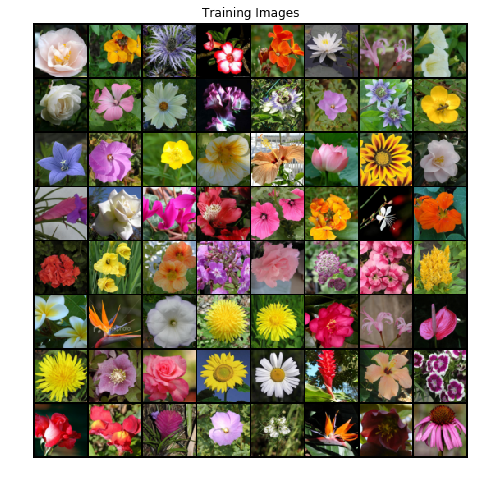

In [4]:
# We can use an image folder dataset the way we have it setup.
# Create the dataset
dataset = dset.ImageFolder(root=dataroot,
                           transform=transforms.Compose([
                               transforms.Resize(image_size),
                               transforms.CenterCrop(image_size),
                               transforms.ToTensor(),
                               transforms.Normalize((0.5, 0.5, 0.5), (0.5, 0.5, 0.5)),
                           ]))
# Create the dataloader
dataloader = torch.utils.data.DataLoader(dataset, batch_size=batch_size,
                                         shuffle=True, num_workers=workers)

# Decide which device we want to run on
device = torch.device("cuda:0" if (torch.cuda.is_available() and ngpu > 0) else "cpu")

# Plot some training images
real_batch = next(iter(dataloader))
plt.figure(figsize=(8,8))
plt.axis("off")
plt.title("Training Images")
plt.imshow(np.transpose(vutils.make_grid(real_batch[0].to(device)[:64], padding=2, normalize=True).cpu(),(1,2,0)))

In [5]:
def weights_init(m):
    classname = m.__class__.__name__
    if classname.find('Conv') != -1:
        nn.init.normal_(m.weight.data, 0.0, 0.02)
    elif classname.find('BatchNorm') != -1:
        nn.init.normal_(m.weight.data, 1.0, 0.02)
        nn.init.constant_(m.bias.data, 0)

In [6]:
# Generator Code

class Generator(nn.Module):
    def __init__(self, ngpu):
        super(Generator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is Z, going into a convolution
            nn.ConvTranspose2d( nz, ngf * 8, 4, 1, 0, bias=False),
            nn.BatchNorm2d(ngf * 8),
            nn.ReLU(True),
            # state size. (ngf*8) x 4 x 4
            nn.ConvTranspose2d(ngf * 8, ngf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 4),
            nn.ReLU(True),
            # state size. (ngf*4) x 8 x 8
            nn.ConvTranspose2d( ngf * 4, ngf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf * 2),
            nn.ReLU(True),
            # state size. (ngf*2) x 16 x 16
            nn.ConvTranspose2d( ngf * 2, ngf, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ngf),
            nn.ReLU(True),
            # state size. (ngf) x 32 x 32
            nn.ConvTranspose2d( ngf, nc, 4, 2, 1, bias=False),
            nn.Tanh()
            # state size. (nc) x 64 x 64
        )

    def forward(self, input):
        return self.main(input)

In [10]:
# Create the generator
netG = Generator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netG = nn.DataParallel(netG, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netG.apply(weights_init)

# Print the model
print(netG)

Generator(
  (main): Sequential(
    (0): ConvTranspose2d(100, 512, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (1): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (2): ReLU(inplace)
    (3): ConvTranspose2d(512, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (4): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (5): ReLU(inplace)
    (6): ConvTranspose2d(256, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (7): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (8): ReLU(inplace)
    (9): ConvTranspose2d(128, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (10): BatchNorm2d(64, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (11): ReLU(inplace)
    (12): ConvTranspose2d(64, 3, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (13): Tanh()
  )
)


In [11]:
class Discriminator(nn.Module):
    def __init__(self, ngpu):
        super(Discriminator, self).__init__()
        self.ngpu = ngpu
        self.main = nn.Sequential(
            # input is (nc) x 64 x 64
            nn.Conv2d(nc, ndf, 4, 2, 1, bias=False),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf) x 32 x 32
            nn.Conv2d(ndf, ndf * 2, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 2),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*2) x 16 x 16
            nn.Conv2d(ndf * 2, ndf * 4, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 4),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*4) x 8 x 8
            nn.Conv2d(ndf * 4, ndf * 8, 4, 2, 1, bias=False),
            nn.BatchNorm2d(ndf * 8),
            nn.LeakyReLU(0.2, inplace=True),
            # state size. (ndf*8) x 4 x 4
            nn.Conv2d(ndf * 8, 1, 4, 1, 0, bias=False),
            nn.Sigmoid()
        )

    def forward(self, input):
        return self.main(input)

In [12]:
# Create the Discriminator
netD = Discriminator(ngpu).to(device)

# Handle multi-gpu if desired
if (device.type == 'cuda') and (ngpu > 1):
    netD = nn.DataParallel(netD, list(range(ngpu)))

# Apply the weights_init function to randomly initialize all weights
#  to mean=0, stdev=0.2.
netD.apply(weights_init)

# Print the model
print(netD)

Discriminator(
  (main): Sequential(
    (0): Conv2d(3, 64, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (1): LeakyReLU(negative_slope=0.2, inplace)
    (2): Conv2d(64, 128, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (3): BatchNorm2d(128, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (4): LeakyReLU(negative_slope=0.2, inplace)
    (5): Conv2d(128, 256, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (6): BatchNorm2d(256, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (7): LeakyReLU(negative_slope=0.2, inplace)
    (8): Conv2d(256, 512, kernel_size=(4, 4), stride=(2, 2), padding=(1, 1), bias=False)
    (9): BatchNorm2d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
    (10): LeakyReLU(negative_slope=0.2, inplace)
    (11): Conv2d(512, 1, kernel_size=(4, 4), stride=(1, 1), bias=False)
    (12): Sigmoid()
  )
)


In [14]:
# Initialize BCELoss function
criterion = nn.BCELoss()

# Create batch of latent vectors that we will use to visualize
#  the progression of the generator
fixed_noise = torch.randn(64, nz, 1, 1, device=device)

# Establish convention for real and fake labels during training
real_label = 1
fake_label = 0

# Setup Adam optimizers for both G and D
optimizerD = optim.Adam(netD.parameters(), lr=0.00015, betas=(beta1, 0.999))
optimizerG = optim.Adam(netG.parameters(), lr=lr, betas=(beta1, 0.999))

In [15]:
# Training Loop
from PIL import ImageFile
ImageFile.LOAD_TRUNCATED_IMAGES = True
# Lists to keep track of progress
img_list = []
G_losses = []
D_losses = []
iters = 0
path1 = "gen_images" # Tähän osoitteeseen kuvat
path2 = "gen"   # Tänne generaattorit
path3 = "dis"   # Tänne diskriminaattorit
print("Starting Training Loop...")
# For each epoch
for epoch in range(num_epochs):
    # For each batch in the dataloader
    for i, data in enumerate(dataloader, 0):

        ############################
        # (1) Update D network: maximize log(D(x)) + log(1 - D(G(z)))
        ###########################
        ## Train with all-real batch
        netD.zero_grad()
        # Format batch
        real_cpu = data[0].to(device)
        b_size = real_cpu.size(0)
        label = torch.full((b_size,), real_label, device=device)
        # Forward pass real batch through D
        output = netD(real_cpu).view(-1)
        # Calculate loss on all-real batch
        errD_real = criterion(output, label)
        # Calculate gradients for D in backward pass
        errD_real.backward()
        D_x = output.mean().item()

        ## Train with all-fake batch
        # Generate batch of latent vectors
        noise = torch.randn(b_size, nz, 1, 1, device=device)
        # Generate fake image batch with G
        fake = netG(noise)
        label.fill_(fake_label)
        # Classify all fake batch with D
        output = netD(fake.detach()).view(-1)
        # Calculate D's loss on the all-fake batch
        errD_fake = criterion(output, label)
        # Calculate the gradients for this batch
        errD_fake.backward()
        D_G_z1 = output.mean().item()
        # Add the gradients from the all-real and all-fake batches
        errD = errD_real + errD_fake
        # Update D
        optimizerD.step()

        ############################
        # (2) Update G network: maximize log(D(G(z)))
        ###########################
        netG.zero_grad()
        label.fill_(real_label)  # fake labels are real for generator cost
        # Since we just updated D, perform another forward pass of all-fake batch through D
        output = netD(fake).view(-1)
        # Calculate G's loss based on this output
        errG = criterion(output, label)
        # Calculate gradients for G
        errG.backward()
        D_G_z2 = output.mean().item()
        # Update G
        optimizerG.step()

        # Output training stats
        if i % 50 == 0:
            print('[%d/%d][%d/%d]\tLoss_D: %.4f\tLoss_G: %.4f\tD(x): %.4f\tD(G(z)): %.4f / %.4f'
                  % (epoch, num_epochs, i, len(dataloader),
                     errD.item(), errG.item(), D_x, D_G_z1, D_G_z2))

        # Save Losses for plotting later
        G_losses.append(errG.item())
        D_losses.append(errD.item())

        # Check how the generator is doing by saving G's output on fixed_noise
        if (iters % 500 == 0) or ((epoch == num_epochs-1) and (i == len(dataloader)-1)):
            with torch.no_grad():
                fake = netG(fixed_noise).detach().cpu()
            img_list.append(vutils.make_grid(fake, padding=2, normalize=True))

        iters += 1
    if (epoch % 50 == 0):
        fake = netG(fixed_noise).detach().cpu()
        vutils.save_image((fake.data), os.path.join(path1, 'fake_images-{}.png'.format(epoch+1)),normalize=True)
        torch.save(netG.state_dict(), os.path.join(path2, 'G--{}.ckpt'.format(epoch+1)))
        torch.save(netD.state_dict(), os.path.join(path3, 'D--{}.ckpt'.format(epoch+1)))

Starting Training Loop...
[0/5001][0/64]	Loss_D: 1.8390	Loss_G: 3.9243	D(x): 0.5050	D(G(z)): 0.5771 / 0.0302
[0/5001][50/64]	Loss_D: 0.7243	Loss_G: 14.0016	D(x): 0.9038	D(G(z)): 0.3633 / 0.0000
[1/5001][0/64]	Loss_D: 0.1965	Loss_G: 4.0946	D(x): 0.9165	D(G(z)): 0.0860 / 0.0255
[1/5001][50/64]	Loss_D: 0.2523	Loss_G: 6.8339	D(x): 0.8817	D(G(z)): 0.0704 / 0.0015
[2/5001][0/64]	Loss_D: 0.4838	Loss_G: 9.5061	D(x): 0.8907	D(G(z)): 0.2763 / 0.0001
[2/5001][50/64]	Loss_D: 0.8479	Loss_G: 4.7547	D(x): 0.5595	D(G(z)): 0.0106 / 0.0165
[3/5001][0/64]	Loss_D: 0.3958	Loss_G: 3.4681	D(x): 0.7642	D(G(z)): 0.0671 / 0.0507
[3/5001][50/64]	Loss_D: 0.7296	Loss_G: 5.1275	D(x): 0.5994	D(G(z)): 0.0157 / 0.0101
[4/5001][0/64]	Loss_D: 1.5937	Loss_G: 4.5939	D(x): 0.3578	D(G(z)): 0.0036 / 0.0235
[4/5001][50/64]	Loss_D: 0.4110	Loss_G: 2.9578	D(x): 0.8093	D(G(z)): 0.1435 / 0.0620
[5/5001][0/64]	Loss_D: 0.1880	Loss_G: 3.5337	D(x): 0.9229	D(G(z)): 0.0969 / 0.0367
[5/5001][50/64]	Loss_D: 0.6852	Loss_G: 1.8724	D(x): 0.6

[48/5001][50/64]	Loss_D: 0.4694	Loss_G: 2.7354	D(x): 0.8127	D(G(z)): 0.2057 / 0.0854
[49/5001][0/64]	Loss_D: 0.5866	Loss_G: 2.3449	D(x): 0.7776	D(G(z)): 0.2577 / 0.1167
[49/5001][50/64]	Loss_D: 0.6005	Loss_G: 2.0930	D(x): 0.7428	D(G(z)): 0.2221 / 0.1487
[50/5001][0/64]	Loss_D: 0.4545	Loss_G: 2.9046	D(x): 0.8734	D(G(z)): 0.2574 / 0.0651
[50/5001][50/64]	Loss_D: 0.6559	Loss_G: 1.8164	D(x): 0.6630	D(G(z)): 0.1776 / 0.1981
[51/5001][0/64]	Loss_D: 0.4863	Loss_G: 2.4944	D(x): 0.7143	D(G(z)): 0.1122 / 0.1018
[51/5001][50/64]	Loss_D: 0.8029	Loss_G: 1.0179	D(x): 0.5632	D(G(z)): 0.1483 / 0.4018
[52/5001][0/64]	Loss_D: 0.5282	Loss_G: 3.4986	D(x): 0.9000	D(G(z)): 0.3197 / 0.0406
[52/5001][50/64]	Loss_D: 1.5706	Loss_G: 5.2055	D(x): 0.9388	D(G(z)): 0.7276 / 0.0076
[53/5001][0/64]	Loss_D: 0.6352	Loss_G: 3.8803	D(x): 0.8725	D(G(z)): 0.3616 / 0.0268
[53/5001][50/64]	Loss_D: 0.5619	Loss_G: 1.7048	D(x): 0.6976	D(G(z)): 0.1467 / 0.2125
[54/5001][0/64]	Loss_D: 0.6085	Loss_G: 1.7986	D(x): 0.6595	D(G(z)): 0.

[97/5001][0/64]	Loss_D: 0.5303	Loss_G: 2.5448	D(x): 0.6710	D(G(z)): 0.0795 / 0.1073
[97/5001][50/64]	Loss_D: 0.3993	Loss_G: 2.3014	D(x): 0.7866	D(G(z)): 0.1248 / 0.1244
[98/5001][0/64]	Loss_D: 0.3692	Loss_G: 2.5446	D(x): 0.8654	D(G(z)): 0.1867 / 0.0953
[98/5001][50/64]	Loss_D: 0.3923	Loss_G: 2.6535	D(x): 0.7868	D(G(z)): 0.1250 / 0.0925
[99/5001][0/64]	Loss_D: 0.3008	Loss_G: 2.9874	D(x): 0.9233	D(G(z)): 0.1837 / 0.0653
[99/5001][50/64]	Loss_D: 0.3358	Loss_G: 2.0824	D(x): 0.8375	D(G(z)): 0.1304 / 0.1602
[100/5001][0/64]	Loss_D: 0.3614	Loss_G: 3.3612	D(x): 0.8937	D(G(z)): 0.2035 / 0.0462
[100/5001][50/64]	Loss_D: 0.4369	Loss_G: 2.7623	D(x): 0.8702	D(G(z)): 0.2354 / 0.0803
[101/5001][0/64]	Loss_D: 0.2592	Loss_G: 2.9361	D(x): 0.8431	D(G(z)): 0.0768 / 0.0691
[101/5001][50/64]	Loss_D: 0.5293	Loss_G: 2.4436	D(x): 0.6982	D(G(z)): 0.1159 / 0.1178
[102/5001][0/64]	Loss_D: 0.3670	Loss_G: 2.4598	D(x): 0.7950	D(G(z)): 0.1062 / 0.1165
[102/5001][50/64]	Loss_D: 0.3881	Loss_G: 2.4014	D(x): 0.7653	D(G(z

[145/5001][0/64]	Loss_D: 0.1483	Loss_G: 4.4199	D(x): 0.9863	D(G(z)): 0.1165 / 0.0156
[145/5001][50/64]	Loss_D: 0.1496	Loss_G: 3.6572	D(x): 0.9603	D(G(z)): 0.0967 / 0.0348
[146/5001][0/64]	Loss_D: 0.1628	Loss_G: 3.9709	D(x): 0.9396	D(G(z)): 0.0895 / 0.0262
[146/5001][50/64]	Loss_D: 0.1282	Loss_G: 3.7979	D(x): 0.9224	D(G(z)): 0.0436 / 0.0329
[147/5001][0/64]	Loss_D: 0.1071	Loss_G: 4.3810	D(x): 0.9627	D(G(z)): 0.0635 / 0.0181
[147/5001][50/64]	Loss_D: 0.1685	Loss_G: 5.1344	D(x): 0.9819	D(G(z)): 0.1290 / 0.0077
[148/5001][0/64]	Loss_D: 2.4816	Loss_G: 0.3412	D(x): 0.2426	D(G(z)): 0.2417 / 0.7415
[148/5001][50/64]	Loss_D: 1.5422	Loss_G: 0.9307	D(x): 0.3415	D(G(z)): 0.1277 / 0.4719
[149/5001][0/64]	Loss_D: 1.5490	Loss_G: 1.0633	D(x): 0.3802	D(G(z)): 0.1040 / 0.4442
[149/5001][50/64]	Loss_D: 0.4845	Loss_G: 4.8005	D(x): 0.9438	D(G(z)): 0.3034 / 0.0116
[150/5001][0/64]	Loss_D: 0.2315	Loss_G: 3.9760	D(x): 0.9322	D(G(z)): 0.1329 / 0.0291
[150/5001][50/64]	Loss_D: 0.1860	Loss_G: 3.4713	D(x): 0.9332

[193/5001][0/64]	Loss_D: 0.0702	Loss_G: 4.6317	D(x): 0.9734	D(G(z)): 0.0407 / 0.0169
[193/5001][50/64]	Loss_D: 0.1043	Loss_G: 4.7171	D(x): 0.9863	D(G(z)): 0.0812 / 0.0122
[194/5001][0/64]	Loss_D: 0.0742	Loss_G: 4.0731	D(x): 0.9574	D(G(z)): 0.0289 / 0.0254
[194/5001][50/64]	Loss_D: 0.0685	Loss_G: 4.6484	D(x): 0.9737	D(G(z)): 0.0392 / 0.0144
[195/5001][0/64]	Loss_D: 0.0706	Loss_G: 4.6620	D(x): 0.9749	D(G(z)): 0.0423 / 0.0160
[195/5001][50/64]	Loss_D: 0.0809	Loss_G: 4.6912	D(x): 0.9685	D(G(z)): 0.0452 / 0.0137
[196/5001][0/64]	Loss_D: 0.0757	Loss_G: 4.0957	D(x): 0.9482	D(G(z)): 0.0209 / 0.0286
[196/5001][50/64]	Loss_D: 0.0523	Loss_G: 4.2499	D(x): 0.9667	D(G(z)): 0.0179 / 0.0215
[197/5001][0/64]	Loss_D: 0.0815	Loss_G: 5.2915	D(x): 0.9875	D(G(z)): 0.0608 / 0.0073
[197/5001][50/64]	Loss_D: 0.0760	Loss_G: 4.8040	D(x): 0.9815	D(G(z)): 0.0533 / 0.0121
[198/5001][0/64]	Loss_D: 0.0467	Loss_G: 4.9437	D(x): 0.9855	D(G(z)): 0.0309 / 0.0108
[198/5001][50/64]	Loss_D: 0.0583	Loss_G: 4.3598	D(x): 0.9728

[241/5001][0/64]	Loss_D: 0.0293	Loss_G: 5.2604	D(x): 0.9810	D(G(z)): 0.0099 / 0.0096
[241/5001][50/64]	Loss_D: 0.0292	Loss_G: 5.4606	D(x): 0.9836	D(G(z)): 0.0123 / 0.0076
[242/5001][0/64]	Loss_D: 0.0444	Loss_G: 6.5730	D(x): 0.9965	D(G(z)): 0.0390 / 0.0018
[242/5001][50/64]	Loss_D: 0.0271	Loss_G: 5.5162	D(x): 0.9881	D(G(z)): 0.0147 / 0.0069
[243/5001][0/64]	Loss_D: 0.0277	Loss_G: 5.4925	D(x): 0.9875	D(G(z)): 0.0145 / 0.0075
[243/5001][50/64]	Loss_D: 0.0180	Loss_G: 6.0084	D(x): 0.9932	D(G(z)): 0.0110 / 0.0046
[244/5001][0/64]	Loss_D: 0.0219	Loss_G: 5.7844	D(x): 0.9923	D(G(z)): 0.0138 / 0.0054
[244/5001][50/64]	Loss_D: 0.0231	Loss_G: 5.7063	D(x): 0.9871	D(G(z)): 0.0100 / 0.0055
[245/5001][0/64]	Loss_D: 0.0253	Loss_G: 5.2077	D(x): 0.9824	D(G(z)): 0.0074 / 0.0095
[245/5001][50/64]	Loss_D: 0.0253	Loss_G: 5.2741	D(x): 0.9853	D(G(z)): 0.0102 / 0.0089
[246/5001][0/64]	Loss_D: 0.0330	Loss_G: 5.4011	D(x): 0.9750	D(G(z)): 0.0074 / 0.0103
[246/5001][50/64]	Loss_D: 1.7222	Loss_G: 0.4255	D(x): 0.3447

[289/5001][0/64]	Loss_D: 0.0138	Loss_G: 6.1385	D(x): 0.9957	D(G(z)): 0.0094 / 0.0037
[289/5001][50/64]	Loss_D: 0.0135	Loss_G: 6.2061	D(x): 0.9937	D(G(z)): 0.0071 / 0.0039
[290/5001][0/64]	Loss_D: 0.0136	Loss_G: 6.3452	D(x): 0.9963	D(G(z)): 0.0096 / 0.0031
[290/5001][50/64]	Loss_D: 0.0180	Loss_G: 5.8121	D(x): 0.9909	D(G(z)): 0.0087 / 0.0054
[291/5001][0/64]	Loss_D: 0.0173	Loss_G: 6.4076	D(x): 0.9901	D(G(z)): 0.0072 / 0.0033
[291/5001][50/64]	Loss_D: 0.0146	Loss_G: 6.0376	D(x): 0.9913	D(G(z)): 0.0058 / 0.0046
[292/5001][0/64]	Loss_D: 0.0163	Loss_G: 6.0352	D(x): 0.9943	D(G(z)): 0.0103 / 0.0038
[292/5001][50/64]	Loss_D: 0.0172	Loss_G: 6.0179	D(x): 0.9930	D(G(z)): 0.0099 / 0.0041
[293/5001][0/64]	Loss_D: 0.0123	Loss_G: 6.6384	D(x): 0.9953	D(G(z)): 0.0074 / 0.0026
[293/5001][50/64]	Loss_D: 0.0197	Loss_G: 6.6851	D(x): 0.9923	D(G(z)): 0.0116 / 0.0022
[294/5001][0/64]	Loss_D: 0.0147	Loss_G: 7.0117	D(x): 0.9957	D(G(z)): 0.0099 / 0.0018
[294/5001][50/64]	Loss_D: 0.0160	Loss_G: 6.0525	D(x): 0.9903

[337/5001][0/64]	Loss_D: 0.0161	Loss_G: 6.3122	D(x): 0.9950	D(G(z)): 0.0107 / 0.0035
[337/5001][50/64]	Loss_D: 0.0181	Loss_G: 6.1563	D(x): 0.9939	D(G(z)): 0.0117 / 0.0044
[338/5001][0/64]	Loss_D: 0.0147	Loss_G: 6.2286	D(x): 0.9966	D(G(z)): 0.0110 / 0.0032
[338/5001][50/64]	Loss_D: 0.0106	Loss_G: 5.9930	D(x): 0.9956	D(G(z)): 0.0061 / 0.0050
[339/5001][0/64]	Loss_D: 0.0104	Loss_G: 6.1987	D(x): 0.9946	D(G(z)): 0.0049 / 0.0040
[339/5001][50/64]	Loss_D: 0.0153	Loss_G: 5.9020	D(x): 0.9903	D(G(z)): 0.0055 / 0.0058
[340/5001][0/64]	Loss_D: 0.0100	Loss_G: 6.7307	D(x): 0.9932	D(G(z)): 0.0031 / 0.0026
[340/5001][50/64]	Loss_D: 0.0161	Loss_G: 6.5332	D(x): 0.9934	D(G(z)): 0.0091 / 0.0029
[341/5001][0/64]	Loss_D: 0.0160	Loss_G: 6.8166	D(x): 0.9967	D(G(z)): 0.0122 / 0.0022
[341/5001][50/64]	Loss_D: 0.0153	Loss_G: 6.5310	D(x): 0.9965	D(G(z)): 0.0116 / 0.0027
[342/5001][0/64]	Loss_D: 0.0158	Loss_G: 6.3769	D(x): 0.9890	D(G(z)): 0.0046 / 0.0040
[342/5001][50/64]	Loss_D: 0.0147	Loss_G: 6.6564	D(x): 0.9952

[385/5001][0/64]	Loss_D: 0.0106	Loss_G: 6.7123	D(x): 0.9961	D(G(z)): 0.0066 / 0.0030
[385/5001][50/64]	Loss_D: 0.0110	Loss_G: 6.5651	D(x): 0.9966	D(G(z)): 0.0075 / 0.0033
[386/5001][0/64]	Loss_D: 0.0116	Loss_G: 6.2284	D(x): 0.9955	D(G(z)): 0.0070 / 0.0047
[386/5001][50/64]	Loss_D: 0.0171	Loss_G: 6.4271	D(x): 0.9968	D(G(z)): 0.0135 / 0.0029
[387/5001][0/64]	Loss_D: 0.0095	Loss_G: 6.3545	D(x): 0.9965	D(G(z)): 0.0059 / 0.0034
[387/5001][50/64]	Loss_D: 0.0132	Loss_G: 6.3764	D(x): 0.9895	D(G(z)): 0.0027 / 0.0040
[388/5001][0/64]	Loss_D: 0.0134	Loss_G: 7.2007	D(x): 0.9964	D(G(z)): 0.0095 / 0.0016
[388/5001][50/64]	Loss_D: 0.0127	Loss_G: 6.1630	D(x): 0.9913	D(G(z)): 0.0040 / 0.0047
[389/5001][0/64]	Loss_D: 0.0110	Loss_G: 6.7417	D(x): 0.9960	D(G(z)): 0.0069 / 0.0025
[389/5001][50/64]	Loss_D: 0.0115	Loss_G: 7.0054	D(x): 0.9960	D(G(z)): 0.0072 / 0.0023
[390/5001][0/64]	Loss_D: 0.0112	Loss_G: 6.8133	D(x): 0.9969	D(G(z)): 0.0080 / 0.0023
[390/5001][50/64]	Loss_D: 0.0111	Loss_G: 6.5562	D(x): 0.9936

[433/5001][0/64]	Loss_D: 0.0231	Loss_G: 5.8399	D(x): 0.9928	D(G(z)): 0.0149 / 0.0067
[433/5001][50/64]	Loss_D: 0.0277	Loss_G: 5.7096	D(x): 0.9879	D(G(z)): 0.0149 / 0.0081
[434/5001][0/64]	Loss_D: 0.0270	Loss_G: 5.8801	D(x): 0.9850	D(G(z)): 0.0115 / 0.0066
[434/5001][50/64]	Loss_D: 0.0323	Loss_G: 6.2264	D(x): 0.9778	D(G(z)): 0.0093 / 0.0061
[435/5001][0/64]	Loss_D: 0.0268	Loss_G: 5.7844	D(x): 0.9855	D(G(z)): 0.0118 / 0.0066
[435/5001][50/64]	Loss_D: 0.0196	Loss_G: 5.7842	D(x): 0.9928	D(G(z)): 0.0120 / 0.0064
[436/5001][0/64]	Loss_D: 0.0200	Loss_G: 5.9778	D(x): 0.9897	D(G(z)): 0.0095 / 0.0053
[436/5001][50/64]	Loss_D: 0.0323	Loss_G: 5.7133	D(x): 0.9891	D(G(z)): 0.0204 / 0.0070
[437/5001][0/64]	Loss_D: 0.0223	Loss_G: 6.2788	D(x): 0.9874	D(G(z)): 0.0092 / 0.0052
[437/5001][50/64]	Loss_D: 0.0155	Loss_G: 5.6893	D(x): 0.9929	D(G(z)): 0.0082 / 0.0066
[438/5001][0/64]	Loss_D: 0.0161	Loss_G: 6.4459	D(x): 0.9925	D(G(z)): 0.0084 / 0.0046
[438/5001][50/64]	Loss_D: 0.0269	Loss_G: 5.7141	D(x): 0.9813

[481/5001][0/64]	Loss_D: 0.0155	Loss_G: 6.1632	D(x): 0.9948	D(G(z)): 0.0101 / 0.0045
[481/5001][50/64]	Loss_D: 0.0170	Loss_G: 6.6098	D(x): 0.9918	D(G(z)): 0.0084 / 0.0039
[482/5001][0/64]	Loss_D: 0.0158	Loss_G: 6.3495	D(x): 0.9957	D(G(z)): 0.0113 / 0.0038
[482/5001][50/64]	Loss_D: 0.0117	Loss_G: 6.3652	D(x): 0.9932	D(G(z)): 0.0048 / 0.0041
[483/5001][0/64]	Loss_D: 0.0127	Loss_G: 6.3316	D(x): 0.9947	D(G(z)): 0.0073 / 0.0041
[483/5001][50/64]	Loss_D: 0.0134	Loss_G: 6.2544	D(x): 0.9932	D(G(z)): 0.0065 / 0.0044
[484/5001][0/64]	Loss_D: 0.0117	Loss_G: 6.8474	D(x): 0.9929	D(G(z)): 0.0045 / 0.0027
[484/5001][50/64]	Loss_D: 0.0125	Loss_G: 6.5154	D(x): 0.9970	D(G(z)): 0.0093 / 0.0044
[485/5001][0/64]	Loss_D: 0.0125	Loss_G: 6.7622	D(x): 0.9949	D(G(z)): 0.0071 / 0.0030
[485/5001][50/64]	Loss_D: 0.0132	Loss_G: 6.6333	D(x): 0.9930	D(G(z)): 0.0061 / 0.0034
[486/5001][0/64]	Loss_D: 0.0135	Loss_G: 6.5847	D(x): 0.9930	D(G(z)): 0.0063 / 0.0041
[486/5001][50/64]	Loss_D: 0.0159	Loss_G: 6.6568	D(x): 0.9928

[529/5001][0/64]	Loss_D: 0.0117	Loss_G: 6.6394	D(x): 0.9947	D(G(z)): 0.0063 / 0.0034
[529/5001][50/64]	Loss_D: 0.0137	Loss_G: 6.6650	D(x): 0.9919	D(G(z)): 0.0054 / 0.0036
[530/5001][0/64]	Loss_D: 0.0126	Loss_G: 6.4726	D(x): 0.9942	D(G(z)): 0.0067 / 0.0039
[530/5001][50/64]	Loss_D: 0.0167	Loss_G: 6.5364	D(x): 0.9950	D(G(z)): 0.0104 / 0.0040
[531/5001][0/64]	Loss_D: 0.0128	Loss_G: 6.4987	D(x): 0.9947	D(G(z)): 0.0073 / 0.0041
[531/5001][50/64]	Loss_D: 0.0095	Loss_G: 6.8094	D(x): 0.9965	D(G(z)): 0.0059 / 0.0032
[532/5001][0/64]	Loss_D: 0.0185	Loss_G: 6.5019	D(x): 0.9958	D(G(z)): 0.0132 / 0.0035
[532/5001][50/64]	Loss_D: 0.0129	Loss_G: 6.5825	D(x): 0.9916	D(G(z)): 0.0044 / 0.0038
[533/5001][0/64]	Loss_D: 0.0144	Loss_G: 6.6207	D(x): 0.9911	D(G(z)): 0.0053 / 0.0043
[533/5001][50/64]	Loss_D: 0.0141	Loss_G: 6.8278	D(x): 0.9964	D(G(z)): 0.0103 / 0.0033
[534/5001][0/64]	Loss_D: 0.0120	Loss_G: 6.4023	D(x): 0.9955	D(G(z)): 0.0072 / 0.0044
[534/5001][50/64]	Loss_D: 0.0089	Loss_G: 7.0151	D(x): 0.9963

[577/5001][0/64]	Loss_D: 0.0351	Loss_G: 6.1319	D(x): 0.9872	D(G(z)): 0.0206 / 0.0063
[577/5001][50/64]	Loss_D: 0.0366	Loss_G: 5.8751	D(x): 0.9874	D(G(z)): 0.0218 / 0.0072
[578/5001][0/64]	Loss_D: 0.0308	Loss_G: 5.9741	D(x): 0.9898	D(G(z)): 0.0194 / 0.0077
[578/5001][50/64]	Loss_D: 0.0402	Loss_G: 5.7325	D(x): 0.9782	D(G(z)): 0.0165 / 0.0088
[579/5001][0/64]	Loss_D: 0.0187	Loss_G: 6.3447	D(x): 0.9942	D(G(z)): 0.0123 / 0.0048
[579/5001][50/64]	Loss_D: 0.0217	Loss_G: 6.0585	D(x): 0.9893	D(G(z)): 0.0105 / 0.0066
[580/5001][0/64]	Loss_D: 0.0306	Loss_G: 6.8615	D(x): 0.9939	D(G(z)): 0.0218 / 0.0042
[580/5001][50/64]	Loss_D: 0.0219	Loss_G: 6.2380	D(x): 0.9922	D(G(z)): 0.0137 / 0.0058
[581/5001][0/64]	Loss_D: 0.0204	Loss_G: 6.3165	D(x): 0.9954	D(G(z)): 0.0151 / 0.0038
[581/5001][50/64]	Loss_D: 0.0212	Loss_G: 6.0586	D(x): 0.9892	D(G(z)): 0.0099 / 0.0062
[582/5001][0/64]	Loss_D: 0.0211	Loss_G: 6.8177	D(x): 0.9926	D(G(z)): 0.0131 / 0.0043
[582/5001][50/64]	Loss_D: 0.0281	Loss_G: 5.4841	D(x): 0.9799

[625/5001][0/64]	Loss_D: 0.0043	Loss_G: 8.2869	D(x): 0.9979	D(G(z)): 0.0021 / 0.0010
[625/5001][50/64]	Loss_D: 0.0033	Loss_G: 8.4630	D(x): 0.9980	D(G(z)): 0.0013 / 0.0007
[626/5001][0/64]	Loss_D: 0.0034	Loss_G: 8.1697	D(x): 0.9973	D(G(z)): 0.0007 / 0.0010
[626/5001][50/64]	Loss_D: 0.0019	Loss_G: 8.4838	D(x): 0.9988	D(G(z)): 0.0007 / 0.0006
[627/5001][0/64]	Loss_D: 0.0035	Loss_G: 8.2509	D(x): 0.9981	D(G(z)): 0.0015 / 0.0009
[627/5001][50/64]	Loss_D: 0.0031	Loss_G: 8.0152	D(x): 0.9980	D(G(z)): 0.0011 / 0.0010
[628/5001][0/64]	Loss_D: 0.0026	Loss_G: 8.2458	D(x): 0.9984	D(G(z)): 0.0010 / 0.0007
[628/5001][50/64]	Loss_D: 0.0037	Loss_G: 8.4318	D(x): 0.9982	D(G(z)): 0.0019 / 0.0007
[629/5001][0/64]	Loss_D: 0.0031	Loss_G: 8.5730	D(x): 0.9989	D(G(z)): 0.0020 / 0.0006
[629/5001][50/64]	Loss_D: 0.0037	Loss_G: 8.7147	D(x): 0.9986	D(G(z)): 0.0023 / 0.0005
[630/5001][0/64]	Loss_D: 0.0023	Loss_G: 8.4668	D(x): 0.9988	D(G(z)): 0.0011 / 0.0007
[630/5001][50/64]	Loss_D: 0.0045	Loss_G: 8.3171	D(x): 0.9978

[673/5001][0/64]	Loss_D: 0.0034	Loss_G: 8.7562	D(x): 0.9988	D(G(z)): 0.0022 / 0.0009
[673/5001][50/64]	Loss_D: 0.0054	Loss_G: 8.3305	D(x): 0.9987	D(G(z)): 0.0039 / 0.0009
[674/5001][0/64]	Loss_D: 0.0064	Loss_G: 8.3644	D(x): 0.9957	D(G(z)): 0.0021 / 0.0013
[674/5001][50/64]	Loss_D: 0.0063	Loss_G: 8.0096	D(x): 0.9974	D(G(z)): 0.0037 / 0.0015
[675/5001][0/64]	Loss_D: 0.0070	Loss_G: 7.9670	D(x): 0.9965	D(G(z)): 0.0034 / 0.0015
[675/5001][50/64]	Loss_D: 0.0060	Loss_G: 7.6295	D(x): 0.9972	D(G(z)): 0.0031 / 0.0018
[676/5001][0/64]	Loss_D: 0.0028	Loss_G: 8.3162	D(x): 0.9988	D(G(z)): 0.0016 / 0.0010
[676/5001][50/64]	Loss_D: 0.0075	Loss_G: 7.9886	D(x): 0.9985	D(G(z)): 0.0058 / 0.0010
[677/5001][0/64]	Loss_D: 0.0036	Loss_G: 8.1065	D(x): 0.9981	D(G(z)): 0.0016 / 0.0011
[677/5001][50/64]	Loss_D: 0.0053	Loss_G: 7.9233	D(x): 0.9983	D(G(z)): 0.0036 / 0.0014
[678/5001][0/64]	Loss_D: 0.0051	Loss_G: 7.7482	D(x): 0.9967	D(G(z)): 0.0018 / 0.0018
[678/5001][50/64]	Loss_D: 0.0063	Loss_G: 8.4590	D(x): 0.9986

[721/5001][0/64]	Loss_D: 0.0056	Loss_G: 8.4891	D(x): 0.9987	D(G(z)): 0.0041 / 0.0010
[721/5001][50/64]	Loss_D: 0.5403	Loss_G: 3.5141	D(x): 0.8328	D(G(z)): 0.2084 / 0.0550
[722/5001][0/64]	Loss_D: 0.6687	Loss_G: 4.1215	D(x): 0.7903	D(G(z)): 0.1966 / 0.0970
[722/5001][50/64]	Loss_D: 0.7870	Loss_G: 4.5754	D(x): 0.6837	D(G(z)): 0.0327 / 0.1238
[723/5001][0/64]	Loss_D: 0.3562	Loss_G: 6.2092	D(x): 0.9197	D(G(z)): 0.1179 / 0.0088
[723/5001][50/64]	Loss_D: 0.1532	Loss_G: 7.1146	D(x): 0.9548	D(G(z)): 0.0525 / 0.0062
[724/5001][0/64]	Loss_D: 0.0880	Loss_G: 7.2464	D(x): 0.9765	D(G(z)): 0.0499 / 0.0031
[724/5001][50/64]	Loss_D: 0.0810	Loss_G: 7.0039	D(x): 0.9654	D(G(z)): 0.0347 / 0.0043
[725/5001][0/64]	Loss_D: 0.0587	Loss_G: 7.2957	D(x): 0.9891	D(G(z)): 0.0396 / 0.0034
[725/5001][50/64]	Loss_D: 0.0500	Loss_G: 6.6260	D(x): 0.9753	D(G(z)): 0.0202 / 0.0055
[726/5001][0/64]	Loss_D: 0.0309	Loss_G: 7.6409	D(x): 0.9902	D(G(z)): 0.0183 / 0.0021
[726/5001][50/64]	Loss_D: 0.0405	Loss_G: 6.9290	D(x): 0.9913

[769/5001][0/64]	Loss_D: 0.0028	Loss_G: 8.6980	D(x): 0.9993	D(G(z)): 0.0021 / 0.0006
[769/5001][50/64]	Loss_D: 0.9204	Loss_G: 2.2054	D(x): 0.6116	D(G(z)): 0.1101 / 0.2347
[770/5001][0/64]	Loss_D: 0.8242	Loss_G: 2.3776	D(x): 0.7105	D(G(z)): 0.1233 / 0.3129
[770/5001][50/64]	Loss_D: 0.7066	Loss_G: 3.9105	D(x): 0.6844	D(G(z)): 0.0484 / 0.1124
[771/5001][0/64]	Loss_D: 0.4577	Loss_G: 6.8409	D(x): 0.9380	D(G(z)): 0.1859 / 0.0060
[771/5001][50/64]	Loss_D: 1.0451	Loss_G: 6.1226	D(x): 0.8698	D(G(z)): 0.3547 / 0.0291
[772/5001][0/64]	Loss_D: 0.4577	Loss_G: 4.7202	D(x): 0.9130	D(G(z)): 0.2253 / 0.0239
[772/5001][50/64]	Loss_D: 0.2305	Loss_G: 6.1918	D(x): 0.9217	D(G(z)): 0.0472 / 0.0149
[773/5001][0/64]	Loss_D: 0.2178	Loss_G: 7.7232	D(x): 0.9730	D(G(z)): 0.0978 / 0.0019
[773/5001][50/64]	Loss_D: 0.1452	Loss_G: 8.1508	D(x): 0.9659	D(G(z)): 0.0668 / 0.0019
[774/5001][0/64]	Loss_D: 0.0642	Loss_G: 8.2241	D(x): 0.9690	D(G(z)): 0.0159 / 0.0040
[774/5001][50/64]	Loss_D: 0.0631	Loss_G: 7.0293	D(x): 0.9903

[817/5001][0/64]	Loss_D: 0.0040	Loss_G: 9.0233	D(x): 0.9989	D(G(z)): 0.0028 / 0.0008
[817/5001][50/64]	Loss_D: 0.0094	Loss_G: 8.7337	D(x): 0.9932	D(G(z)): 0.0022 / 0.0009
[818/5001][0/64]	Loss_D: 0.0024	Loss_G: 8.9334	D(x): 0.9993	D(G(z)): 0.0017 / 0.0008
[818/5001][50/64]	Loss_D: 0.0049	Loss_G: 9.0363	D(x): 0.9966	D(G(z)): 0.0015 / 0.0006
[819/5001][0/64]	Loss_D: 0.0026	Loss_G: 9.7384	D(x): 0.9985	D(G(z)): 0.0010 / 0.0004
[819/5001][50/64]	Loss_D: 0.0031	Loss_G: 8.6618	D(x): 0.9995	D(G(z)): 0.0026 / 0.0013
[820/5001][0/64]	Loss_D: 0.0039	Loss_G: 9.1717	D(x): 0.9989	D(G(z)): 0.0027 / 0.0006
[820/5001][50/64]	Loss_D: 0.0032	Loss_G: 8.9907	D(x): 0.9990	D(G(z)): 0.0022 / 0.0006
[821/5001][0/64]	Loss_D: 0.0031	Loss_G: 10.0703	D(x): 0.9978	D(G(z)): 0.0009 / 0.0005
[821/5001][50/64]	Loss_D: 0.5902	Loss_G: 4.9774	D(x): 0.8807	D(G(z)): 0.2366 / 0.0269
[822/5001][0/64]	Loss_D: 1.0210	Loss_G: 2.8022	D(x): 0.5671	D(G(z)): 0.0254 / 0.2641
[822/5001][50/64]	Loss_D: 0.9087	Loss_G: 3.9778	D(x): 0.665

[865/5001][0/64]	Loss_D: 0.2281	Loss_G: 6.5022	D(x): 0.9201	D(G(z)): 0.0424 / 0.0221
[865/5001][50/64]	Loss_D: 0.1243	Loss_G: 7.7619	D(x): 0.9618	D(G(z)): 0.0446 / 0.0030
[866/5001][0/64]	Loss_D: 0.0678	Loss_G: 7.8284	D(x): 0.9932	D(G(z)): 0.0501 / 0.0020
[866/5001][50/64]	Loss_D: 0.0503	Loss_G: 7.4275	D(x): 0.9660	D(G(z)): 0.0082 / 0.0046
[867/5001][0/64]	Loss_D: 0.0314	Loss_G: 8.5948	D(x): 0.9873	D(G(z)): 0.0118 / 0.0014
[867/5001][50/64]	Loss_D: 0.0343	Loss_G: 7.6127	D(x): 0.9736	D(G(z)): 0.0051 / 0.0039
[868/5001][0/64]	Loss_D: 0.0230	Loss_G: 7.3676	D(x): 0.9907	D(G(z)): 0.0123 / 0.0046
[868/5001][50/64]	Loss_D: 0.0304	Loss_G: 6.7235	D(x): 0.9896	D(G(z)): 0.0137 / 0.0055
[869/5001][0/64]	Loss_D: 0.0153	Loss_G: 8.0683	D(x): 0.9941	D(G(z)): 0.0086 / 0.0026
[869/5001][50/64]	Loss_D: 0.0239	Loss_G: 7.2494	D(x): 0.9847	D(G(z)): 0.0064 / 0.0046
[870/5001][0/64]	Loss_D: 0.0162	Loss_G: 7.7740	D(x): 0.9973	D(G(z)): 0.0124 / 0.0022
[870/5001][50/64]	Loss_D: 0.0314	Loss_G: 7.1613	D(x): 0.9779

[913/5001][0/64]	Loss_D: 0.0177	Loss_G: 8.2239	D(x): 0.9916	D(G(z)): 0.0083 / 0.0019
[913/5001][50/64]	Loss_D: 0.0090	Loss_G: 7.8470	D(x): 0.9954	D(G(z)): 0.0043 / 0.0025
[914/5001][0/64]	Loss_D: 0.0090	Loss_G: 8.1352	D(x): 0.9965	D(G(z)): 0.0053 / 0.0020
[914/5001][50/64]	Loss_D: 0.0091	Loss_G: 7.8987	D(x): 0.9976	D(G(z)): 0.0063 / 0.0024
[915/5001][0/64]	Loss_D: 0.0090	Loss_G: 7.7236	D(x): 0.9973	D(G(z)): 0.0062 / 0.0025
[915/5001][50/64]	Loss_D: 0.0095	Loss_G: 8.1074	D(x): 0.9931	D(G(z)): 0.0023 / 0.0015
[916/5001][0/64]	Loss_D: 0.0111	Loss_G: 8.4226	D(x): 0.9929	D(G(z)): 0.0034 / 0.0011
[916/5001][50/64]	Loss_D: 0.0101	Loss_G: 8.2112	D(x): 0.9966	D(G(z)): 0.0063 / 0.0020
[917/5001][0/64]	Loss_D: 0.0101	Loss_G: 8.4562	D(x): 0.9919	D(G(z)): 0.0017 / 0.0019
[917/5001][50/64]	Loss_D: 0.0087	Loss_G: 7.8357	D(x): 0.9962	D(G(z)): 0.0047 / 0.0021
[918/5001][0/64]	Loss_D: 0.0141	Loss_G: 8.1570	D(x): 0.9916	D(G(z)): 0.0050 / 0.0017
[918/5001][50/64]	Loss_D: 0.0057	Loss_G: 8.1284	D(x): 0.9965

[961/5001][0/64]	Loss_D: 0.0262	Loss_G: 7.8360	D(x): 0.9887	D(G(z)): 0.0131 / 0.0028
[961/5001][50/64]	Loss_D: 0.0410	Loss_G: 7.6086	D(x): 0.9828	D(G(z)): 0.0117 / 0.0035
[962/5001][0/64]	Loss_D: 0.0089	Loss_G: 8.7616	D(x): 0.9942	D(G(z)): 0.0031 / 0.0012
[962/5001][50/64]	Loss_D: 0.0195	Loss_G: 8.3088	D(x): 0.9917	D(G(z)): 0.0096 / 0.0023
[963/5001][0/64]	Loss_D: 0.0107	Loss_G: 8.2685	D(x): 0.9941	D(G(z)): 0.0045 / 0.0022
[963/5001][50/64]	Loss_D: 0.0206	Loss_G: 9.3658	D(x): 0.9834	D(G(z)): 0.0024 / 0.0015
[964/5001][0/64]	Loss_D: 0.0135	Loss_G: 9.5722	D(x): 0.9972	D(G(z)): 0.0091 / 0.0016
[964/5001][50/64]	Loss_D: 0.0251	Loss_G: 9.0375	D(x): 0.9928	D(G(z)): 0.0099 / 0.0016
[965/5001][0/64]	Loss_D: 0.0175	Loss_G: 7.9257	D(x): 0.9861	D(G(z)): 0.0024 / 0.0019
[965/5001][50/64]	Loss_D: 0.0098	Loss_G: 8.1888	D(x): 0.9938	D(G(z)): 0.0033 / 0.0020
[966/5001][0/64]	Loss_D: 0.0082	Loss_G: 7.7257	D(x): 0.9955	D(G(z)): 0.0035 / 0.0030
[966/5001][50/64]	Loss_D: 0.0141	Loss_G: 8.1253	D(x): 0.9914

[1009/5001][0/64]	Loss_D: 0.0037	Loss_G: 12.4150	D(x): 0.9987	D(G(z)): 0.0024 / 0.0011
[1009/5001][50/64]	Loss_D: 0.0205	Loss_G: 10.9160	D(x): 0.9931	D(G(z)): 0.0109 / 0.0009
[1010/5001][0/64]	Loss_D: 0.0061	Loss_G: 9.7056	D(x): 0.9980	D(G(z)): 0.0039 / 0.0011
[1010/5001][50/64]	Loss_D: 0.0104	Loss_G: 10.5321	D(x): 0.9917	D(G(z)): 0.0016 / 0.0011
[1011/5001][0/64]	Loss_D: 0.0053	Loss_G: 9.1440	D(x): 0.9977	D(G(z)): 0.0029 / 0.0014
[1011/5001][50/64]	Loss_D: 0.0072	Loss_G: 9.1878	D(x): 0.9947	D(G(z)): 0.0013 / 0.0011
[1012/5001][0/64]	Loss_D: 0.0027	Loss_G: 9.6753	D(x): 0.9980	D(G(z)): 0.0006 / 0.0004
[1012/5001][50/64]	Loss_D: 0.0072	Loss_G: 8.1332	D(x): 0.9980	D(G(z)): 0.0048 / 0.0017
[1013/5001][0/64]	Loss_D: 0.0030	Loss_G: 8.3509	D(x): 0.9989	D(G(z)): 0.0020 / 0.0012
[1013/5001][50/64]	Loss_D: 0.0052	Loss_G: 8.8481	D(x): 0.9969	D(G(z)): 0.0021 / 0.0013
[1014/5001][0/64]	Loss_D: 0.0058	Loss_G: 8.9673	D(x): 0.9956	D(G(z)): 0.0013 / 0.0012
[1014/5001][50/64]	Loss_D: 0.0103	Loss_G: 8.54

[1056/5001][50/64]	Loss_D: 0.0128	Loss_G: 8.1764	D(x): 0.9978	D(G(z)): 0.0094 / 0.0019
[1057/5001][0/64]	Loss_D: 0.0082	Loss_G: 9.2528	D(x): 0.9985	D(G(z)): 0.0061 / 0.0011
[1057/5001][50/64]	Loss_D: 0.0088	Loss_G: 8.1609	D(x): 0.9954	D(G(z)): 0.0039 / 0.0017
[1058/5001][0/64]	Loss_D: 0.0032	Loss_G: 10.4780	D(x): 0.9980	D(G(z)): 0.0012 / 0.0005
[1058/5001][50/64]	Loss_D: 0.0085	Loss_G: 8.4071	D(x): 0.9934	D(G(z)): 0.0016 / 0.0017
[1059/5001][0/64]	Loss_D: 0.0019	Loss_G: 9.7862	D(x): 0.9989	D(G(z)): 0.0008 / 0.0005
[1059/5001][50/64]	Loss_D: 0.0043	Loss_G: 9.2471	D(x): 0.9972	D(G(z)): 0.0014 / 0.0009
[1060/5001][0/64]	Loss_D: 0.0042	Loss_G: 8.5958	D(x): 0.9982	D(G(z)): 0.0023 / 0.0012
[1060/5001][50/64]	Loss_D: 0.0106	Loss_G: 8.1725	D(x): 0.9965	D(G(z)): 0.0068 / 0.0018
[1061/5001][0/64]	Loss_D: 0.0039	Loss_G: 9.2733	D(x): 0.9984	D(G(z)): 0.0022 / 0.0008
[1061/5001][50/64]	Loss_D: 0.0090	Loss_G: 8.9080	D(x): 0.9974	D(G(z)): 0.0058 / 0.0011
[1062/5001][0/64]	Loss_D: 0.0052	Loss_G: 8.5421

[1104/5001][0/64]	Loss_D: 0.0067	Loss_G: 9.4177	D(x): 0.9970	D(G(z)): 0.0035 / 0.0006
[1104/5001][50/64]	Loss_D: 0.0028	Loss_G: 9.5617	D(x): 0.9983	D(G(z)): 0.0010 / 0.0005
[1105/5001][0/64]	Loss_D: 0.0037	Loss_G: 9.0334	D(x): 0.9987	D(G(z)): 0.0023 / 0.0007
[1105/5001][50/64]	Loss_D: 0.0044	Loss_G: 8.8662	D(x): 0.9985	D(G(z)): 0.0029 / 0.0007
[1106/5001][0/64]	Loss_D: 0.0028	Loss_G: 9.3854	D(x): 0.9987	D(G(z)): 0.0015 / 0.0007
[1106/5001][50/64]	Loss_D: 0.0044	Loss_G: 8.8719	D(x): 0.9972	D(G(z)): 0.0016 / 0.0009
[1107/5001][0/64]	Loss_D: 0.0040	Loss_G: 9.5709	D(x): 0.9981	D(G(z)): 0.0020 / 0.0007
[1107/5001][50/64]	Loss_D: 0.0050	Loss_G: 9.1263	D(x): 0.9957	D(G(z)): 0.0006 / 0.0006
[1108/5001][0/64]	Loss_D: 0.0018	Loss_G: 10.0845	D(x): 0.9990	D(G(z)): 0.0008 / 0.0007
[1108/5001][50/64]	Loss_D: 0.0045	Loss_G: 10.0226	D(x): 0.9985	D(G(z)): 0.0030 / 0.0004
[1109/5001][0/64]	Loss_D: 0.0073	Loss_G: 9.4836	D(x): 0.9977	D(G(z)): 0.0046 / 0.0007
[1109/5001][50/64]	Loss_D: 0.0020	Loss_G: 12.73

[1151/5001][50/64]	Loss_D: 0.0065	Loss_G: 9.3081	D(x): 0.9964	D(G(z)): 0.0027 / 0.0008
[1152/5001][0/64]	Loss_D: 0.0047	Loss_G: 9.0637	D(x): 0.9969	D(G(z)): 0.0015 / 0.0008
[1152/5001][50/64]	Loss_D: 0.0070	Loss_G: 9.8485	D(x): 0.9982	D(G(z)): 0.0050 / 0.0006
[1153/5001][0/64]	Loss_D: 0.0069	Loss_G: 10.7779	D(x): 0.9970	D(G(z)): 0.0038 / 0.0010
[1153/5001][50/64]	Loss_D: 0.0029	Loss_G: 9.1889	D(x): 0.9989	D(G(z)): 0.0017 / 0.0006
[1154/5001][0/64]	Loss_D: 0.0046	Loss_G: 9.2312	D(x): 0.9996	D(G(z)): 0.0041 / 0.0006
[1154/5001][50/64]	Loss_D: 0.0022	Loss_G: 10.6061	D(x): 0.9986	D(G(z)): 0.0008 / 0.0006
[1155/5001][0/64]	Loss_D: 0.0056	Loss_G: 9.7997	D(x): 0.9984	D(G(z)): 0.0038 / 0.0005
[1155/5001][50/64]	Loss_D: 0.0024	Loss_G: 9.3796	D(x): 0.9985	D(G(z)): 0.0009 / 0.0006
[1156/5001][0/64]	Loss_D: 0.0098	Loss_G: 8.3723	D(x): 0.9932	D(G(z)): 0.0026 / 0.0029
[1156/5001][50/64]	Loss_D: 0.0028	Loss_G: 10.2313	D(x): 0.9986	D(G(z)): 0.0014 / 0.0002
[1157/5001][0/64]	Loss_D: 0.0040	Loss_G: 9.75

[1199/5001][0/64]	Loss_D: 0.1243	Loss_G: 10.2053	D(x): 0.9873	D(G(z)): 0.0609 / 0.0006
[1199/5001][50/64]	Loss_D: 0.0536	Loss_G: 9.9637	D(x): 0.9868	D(G(z)): 0.0327 / 0.0016
[1200/5001][0/64]	Loss_D: 0.0186	Loss_G: 8.0437	D(x): 0.9921	D(G(z)): 0.0094 / 0.0030
[1200/5001][50/64]	Loss_D: 0.0304	Loss_G: 9.2141	D(x): 0.9824	D(G(z)): 0.0074 / 0.0031
[1201/5001][0/64]	Loss_D: 0.0296	Loss_G: 7.9357	D(x): 0.9910	D(G(z)): 0.0186 / 0.0024
[1201/5001][50/64]	Loss_D: 0.0229	Loss_G: 8.6376	D(x): 0.9891	D(G(z)): 0.0094 / 0.0036
[1202/5001][0/64]	Loss_D: 0.0125	Loss_G: 8.7681	D(x): 0.9937	D(G(z)): 0.0054 / 0.0024
[1202/5001][50/64]	Loss_D: 0.0166	Loss_G: 8.8889	D(x): 0.9903	D(G(z)): 0.0053 / 0.0021
[1203/5001][0/64]	Loss_D: 0.0133	Loss_G: 7.9625	D(x): 0.9967	D(G(z)): 0.0093 / 0.0026
[1203/5001][50/64]	Loss_D: 0.0051	Loss_G: 8.6851	D(x): 0.9971	D(G(z)): 0.0022 / 0.0022
[1204/5001][0/64]	Loss_D: 0.0138	Loss_G: 9.2920	D(x): 0.9993	D(G(z)): 0.0119 / 0.0011
[1204/5001][50/64]	Loss_D: 0.0127	Loss_G: 8.1611

[1246/5001][50/64]	Loss_D: 0.0167	Loss_G: 8.8033	D(x): 0.9892	D(G(z)): 0.0050 / 0.0018
[1247/5001][0/64]	Loss_D: 0.0138	Loss_G: 8.9381	D(x): 0.9949	D(G(z)): 0.0066 / 0.0014
[1247/5001][50/64]	Loss_D: 0.0102	Loss_G: 8.3188	D(x): 0.9957	D(G(z)): 0.0057 / 0.0021
[1248/5001][0/64]	Loss_D: 0.0097	Loss_G: 8.6662	D(x): 0.9982	D(G(z)): 0.0077 / 0.0014
[1248/5001][50/64]	Loss_D: 0.0175	Loss_G: 11.6470	D(x): 0.9863	D(G(z)): 0.0023 / 0.0017
[1249/5001][0/64]	Loss_D: 0.0155	Loss_G: 11.5504	D(x): 0.9883	D(G(z)): 0.0031 / 0.0033
[1249/5001][50/64]	Loss_D: 0.0083	Loss_G: 10.8296	D(x): 0.9971	D(G(z)): 0.0051 / 0.0019
[1250/5001][0/64]	Loss_D: 0.0142	Loss_G: 10.4828	D(x): 0.9947	D(G(z)): 0.0082 / 0.0029
[1250/5001][50/64]	Loss_D: 0.0076	Loss_G: 8.1297	D(x): 0.9960	D(G(z)): 0.0035 / 0.0019
[1251/5001][0/64]	Loss_D: 0.0123	Loss_G: 8.8146	D(x): 0.9987	D(G(z)): 0.0095 / 0.0013
[1251/5001][50/64]	Loss_D: 0.0137	Loss_G: 8.3186	D(x): 0.9909	D(G(z)): 0.0033 / 0.0017
[1252/5001][0/64]	Loss_D: 0.0054	Loss_G: 8.0

[1294/5001][0/64]	Loss_D: 0.0044	Loss_G: 8.4471	D(x): 0.9981	D(G(z)): 0.0024 / 0.0017
[1294/5001][50/64]	Loss_D: 0.0096	Loss_G: 8.3528	D(x): 0.9929	D(G(z)): 0.0021 / 0.0017
[1295/5001][0/64]	Loss_D: 0.0071	Loss_G: 9.0014	D(x): 0.9957	D(G(z)): 0.0026 / 0.0014
[1295/5001][50/64]	Loss_D: 0.0123	Loss_G: 8.9475	D(x): 0.9949	D(G(z)): 0.0067 / 0.0019
[1296/5001][0/64]	Loss_D: 0.0043	Loss_G: 9.0950	D(x): 0.9989	D(G(z)): 0.0031 / 0.0010
[1296/5001][50/64]	Loss_D: 0.0055	Loss_G: 8.6527	D(x): 0.9980	D(G(z)): 0.0033 / 0.0012
[1297/5001][0/64]	Loss_D: 0.0025	Loss_G: 9.5925	D(x): 0.9996	D(G(z)): 0.0020 / 0.0014
[1297/5001][50/64]	Loss_D: 0.0181	Loss_G: 9.6417	D(x): 0.9961	D(G(z)): 0.0083 / 0.0004
[1298/5001][0/64]	Loss_D: 0.0084	Loss_G: 8.9473	D(x): 0.9955	D(G(z)): 0.0036 / 0.0010
[1298/5001][50/64]	Loss_D: 0.0060	Loss_G: 8.3907	D(x): 0.9969	D(G(z)): 0.0029 / 0.0016
[1299/5001][0/64]	Loss_D: 0.0034	Loss_G: 10.4919	D(x): 0.9974	D(G(z)): 0.0008 / 0.0006
[1299/5001][50/64]	Loss_D: 0.0049	Loss_G: 10.328

[1341/5001][50/64]	Loss_D: 0.0081	Loss_G: 9.2675	D(x): 0.9983	D(G(z)): 0.0062 / 0.0017
[1342/5001][0/64]	Loss_D: 0.0053	Loss_G: 8.9546	D(x): 0.9993	D(G(z)): 0.0043 / 0.0009
[1342/5001][50/64]	Loss_D: 0.0045	Loss_G: 8.5045	D(x): 0.9981	D(G(z)): 0.0026 / 0.0012
[1343/5001][0/64]	Loss_D: 0.0088	Loss_G: 11.4388	D(x): 0.9987	D(G(z)): 0.0072 / 0.0010
[1343/5001][50/64]	Loss_D: 0.0061	Loss_G: 8.4015	D(x): 0.9980	D(G(z)): 0.0040 / 0.0017
[1344/5001][0/64]	Loss_D: 0.0044	Loss_G: 9.8804	D(x): 0.9984	D(G(z)): 0.0026 / 0.0006
[1344/5001][50/64]	Loss_D: 0.0137	Loss_G: 11.8496	D(x): 0.9974	D(G(z)): 0.0090 / 0.0009
[1345/5001][0/64]	Loss_D: 0.0041	Loss_G: 10.5906	D(x): 0.9974	D(G(z)): 0.0015 / 0.0009
[1345/5001][50/64]	Loss_D: 0.0057	Loss_G: 10.9179	D(x): 0.9947	D(G(z)): 0.0003 / 0.0003
[1346/5001][0/64]	Loss_D: 0.0055	Loss_G: 9.0570	D(x): 0.9985	D(G(z)): 0.0039 / 0.0009
[1346/5001][50/64]	Loss_D: 0.0039	Loss_G: 10.8134	D(x): 0.9979	D(G(z)): 0.0017 / 0.0008
[1347/5001][0/64]	Loss_D: 0.0114	Loss_G: 10

[1389/5001][0/64]	Loss_D: 0.0214	Loss_G: 9.9864	D(x): 0.9957	D(G(z)): 0.0146 / 0.0018
[1389/5001][50/64]	Loss_D: 0.0550	Loss_G: 10.5125	D(x): 0.9675	D(G(z)): 0.0043 / 0.0011
[1390/5001][0/64]	Loss_D: 0.0309	Loss_G: 9.1947	D(x): 0.9992	D(G(z)): 0.0228 / 0.0008
[1390/5001][50/64]	Loss_D: 0.0592	Loss_G: 11.2308	D(x): 0.9955	D(G(z)): 0.0237 / 0.0003
[1391/5001][0/64]	Loss_D: 0.0154	Loss_G: 9.9402	D(x): 0.9977	D(G(z)): 0.0109 / 0.0007
[1391/5001][50/64]	Loss_D: 0.0131	Loss_G: 11.2655	D(x): 0.9928	D(G(z)): 0.0049 / 0.0019
[1392/5001][0/64]	Loss_D: 0.0087	Loss_G: 10.0583	D(x): 0.9976	D(G(z)): 0.0058 / 0.0018
[1392/5001][50/64]	Loss_D: 0.0072	Loss_G: 9.5752	D(x): 0.9967	D(G(z)): 0.0038 / 0.0019
[1393/5001][0/64]	Loss_D: 0.0123	Loss_G: 10.9008	D(x): 0.9928	D(G(z)): 0.0042 / 0.0010
[1393/5001][50/64]	Loss_D: 0.0081	Loss_G: 10.4310	D(x): 0.9940	D(G(z)): 0.0019 / 0.0015
[1394/5001][0/64]	Loss_D: 0.0380	Loss_G: 12.3432	D(x): 0.9762	D(G(z)): 0.0070 / 0.0132
[1394/5001][50/64]	Loss_D: 0.0086	Loss_G: 

[1436/5001][50/64]	Loss_D: 0.0046	Loss_G: 9.8440	D(x): 0.9967	D(G(z)): 0.0012 / 0.0008
[1437/5001][0/64]	Loss_D: 0.0051	Loss_G: 9.5108	D(x): 0.9975	D(G(z)): 0.0025 / 0.0009
[1437/5001][50/64]	Loss_D: 0.0030	Loss_G: 9.2868	D(x): 0.9996	D(G(z)): 0.0026 / 0.0010
[1438/5001][0/64]	Loss_D: 0.0072	Loss_G: 11.1303	D(x): 0.9995	D(G(z)): 0.0054 / 0.0002
[1438/5001][50/64]	Loss_D: 0.0064	Loss_G: 9.4955	D(x): 0.9990	D(G(z)): 0.0048 / 0.0008
[1439/5001][0/64]	Loss_D: 0.0039	Loss_G: 9.6281	D(x): 0.9979	D(G(z)): 0.0017 / 0.0009
[1439/5001][50/64]	Loss_D: 0.0122	Loss_G: 9.4031	D(x): 0.9898	D(G(z)): 0.0014 / 0.0019
[1440/5001][0/64]	Loss_D: 0.0019	Loss_G: 10.1469	D(x): 0.9993	D(G(z)): 0.0012 / 0.0006
[1440/5001][50/64]	Loss_D: 0.0052	Loss_G: 10.1316	D(x): 0.9962	D(G(z)): 0.0012 / 0.0004
[1441/5001][0/64]	Loss_D: 0.0057	Loss_G: 9.6329	D(x): 0.9996	D(G(z)): 0.0052 / 0.0005
[1441/5001][50/64]	Loss_D: 0.0020	Loss_G: 9.5661	D(x): 0.9993	D(G(z)): 0.0012 / 0.0006
[1442/5001][0/64]	Loss_D: 0.0041	Loss_G: 9.61

[1484/5001][0/64]	Loss_D: 0.0082	Loss_G: 8.9473	D(x): 0.9987	D(G(z)): 0.0063 / 0.0013
[1484/5001][50/64]	Loss_D: 0.0073	Loss_G: 11.5734	D(x): 0.9981	D(G(z)): 0.0052 / 0.0015
[1485/5001][0/64]	Loss_D: 0.0210	Loss_G: 13.0434	D(x): 0.9990	D(G(z)): 0.0151 / 0.0005
[1485/5001][50/64]	Loss_D: 0.0061	Loss_G: 10.7460	D(x): 0.9973	D(G(z)): 0.0033 / 0.0021
[1486/5001][0/64]	Loss_D: 0.0247	Loss_G: 11.5856	D(x): 0.9982	D(G(z)): 0.0125 / 0.0005
[1486/5001][50/64]	Loss_D: 0.0144	Loss_G: 9.6632	D(x): 0.9961	D(G(z)): 0.0094 / 0.0011
[1487/5001][0/64]	Loss_D: 0.0039	Loss_G: 11.1690	D(x): 0.9965	D(G(z)): 0.0004 / 0.0003
[1487/5001][50/64]	Loss_D: 0.0052	Loss_G: 9.6659	D(x): 0.9993	D(G(z)): 0.0040 / 0.0005
[1488/5001][0/64]	Loss_D: 0.0074	Loss_G: 10.3499	D(x): 0.9931	D(G(z)): 0.0003 / 0.0005
[1488/5001][50/64]	Loss_D: 0.0048	Loss_G: 9.5926	D(x): 0.9964	D(G(z)): 0.0011 / 0.0008
[1489/5001][0/64]	Loss_D: 0.0074	Loss_G: 9.3302	D(x): 0.9942	D(G(z)): 0.0013 / 0.0013
[1489/5001][50/64]	Loss_D: 0.0041	Loss_G: 1

[1531/5001][50/64]	Loss_D: 0.0071	Loss_G: 9.5650	D(x): 0.9986	D(G(z)): 0.0054 / 0.0006
[1532/5001][0/64]	Loss_D: 0.0100	Loss_G: 9.4991	D(x): 0.9979	D(G(z)): 0.0075 / 0.0012
[1532/5001][50/64]	Loss_D: 0.0067	Loss_G: 9.2621	D(x): 0.9966	D(G(z)): 0.0032 / 0.0013
[1533/5001][0/64]	Loss_D: 0.0034	Loss_G: 9.6197	D(x): 0.9984	D(G(z)): 0.0017 / 0.0007
[1533/5001][50/64]	Loss_D: 0.0063	Loss_G: 9.5930	D(x): 0.9973	D(G(z)): 0.0034 / 0.0009
[1534/5001][0/64]	Loss_D: 0.0039	Loss_G: 9.7689	D(x): 0.9991	D(G(z)): 0.0029 / 0.0008
[1534/5001][50/64]	Loss_D: 0.0062	Loss_G: 10.4670	D(x): 0.9961	D(G(z)): 0.0020 / 0.0012
[1535/5001][0/64]	Loss_D: 0.0071	Loss_G: 9.8895	D(x): 0.9946	D(G(z)): 0.0013 / 0.0009
[1535/5001][50/64]	Loss_D: 0.0146	Loss_G: 11.6414	D(x): 0.9918	D(G(z)): 0.0036 / 0.0019
[1536/5001][0/64]	Loss_D: 0.0031	Loss_G: 11.8561	D(x): 0.9983	D(G(z)): 0.0014 / 0.0005
[1536/5001][50/64]	Loss_D: 0.0041	Loss_G: 10.6011	D(x): 0.9970	D(G(z)): 0.0010 / 0.0004
[1537/5001][0/64]	Loss_D: 0.0046	Loss_G: 10.

[1579/5001][0/64]	Loss_D: 0.0024	Loss_G: 10.0340	D(x): 0.9993	D(G(z)): 0.0017 / 0.0008
[1579/5001][50/64]	Loss_D: 0.0135	Loss_G: 11.7040	D(x): 0.9882	D(G(z)): 0.0003 / 0.0006
[1580/5001][0/64]	Loss_D: 0.0032	Loss_G: 10.2088	D(x): 0.9977	D(G(z)): 0.0008 / 0.0005
[1580/5001][50/64]	Loss_D: 0.0103	Loss_G: 10.4567	D(x): 0.9956	D(G(z)): 0.0046 / 0.0005
[1581/5001][0/64]	Loss_D: 0.0065	Loss_G: 12.8172	D(x): 0.9964	D(G(z)): 0.0022 / 0.0003
[1581/5001][50/64]	Loss_D: 0.0021	Loss_G: 12.3409	D(x): 0.9991	D(G(z)): 0.0012 / 0.0007
[1582/5001][0/64]	Loss_D: 0.0079	Loss_G: 11.7812	D(x): 0.9987	D(G(z)): 0.0065 / 0.0005
[1582/5001][50/64]	Loss_D: 0.0028	Loss_G: 10.0949	D(x): 0.9993	D(G(z)): 0.0020 / 0.0011
[1583/5001][0/64]	Loss_D: 0.0078	Loss_G: 13.2196	D(x): 0.9991	D(G(z)): 0.0063 / 0.0007
[1583/5001][50/64]	Loss_D: 0.0057	Loss_G: 9.9167	D(x): 0.9971	D(G(z)): 0.0024 / 0.0017
[1584/5001][0/64]	Loss_D: 0.0012	Loss_G: 10.7477	D(x): 0.9994	D(G(z)): 0.0006 / 0.0003
[1584/5001][50/64]	Loss_D: 0.0034	Loss_

[1626/5001][0/64]	Loss_D: 0.0206	Loss_G: 10.6094	D(x): 0.9980	D(G(z)): 0.0130 / 0.0006
[1626/5001][50/64]	Loss_D: 0.0087	Loss_G: 13.1830	D(x): 0.9956	D(G(z)): 0.0038 / 0.0009
[1627/5001][0/64]	Loss_D: 0.0113	Loss_G: 11.6140	D(x): 0.9968	D(G(z)): 0.0070 / 0.0014
[1627/5001][50/64]	Loss_D: 0.0254	Loss_G: 12.7127	D(x): 0.9928	D(G(z)): 0.0092 / 0.0011
[1628/5001][0/64]	Loss_D: 0.0082	Loss_G: 11.0515	D(x): 0.9968	D(G(z)): 0.0047 / 0.0011
[1628/5001][50/64]	Loss_D: 0.0408	Loss_G: 12.0420	D(x): 0.9982	D(G(z)): 0.0214 / 0.0009
[1629/5001][0/64]	Loss_D: 0.0069	Loss_G: 10.8328	D(x): 0.9943	D(G(z)): 0.0010 / 0.0007
[1629/5001][50/64]	Loss_D: 0.0227	Loss_G: 10.6751	D(x): 0.9901	D(G(z)): 0.0106 / 0.0018
[1630/5001][0/64]	Loss_D: 0.0092	Loss_G: 10.5061	D(x): 0.9984	D(G(z)): 0.0064 / 0.0008
[1630/5001][50/64]	Loss_D: 0.0193	Loss_G: 10.0483	D(x): 0.9979	D(G(z)): 0.0105 / 0.0007
[1631/5001][0/64]	Loss_D: 0.0082	Loss_G: 8.9246	D(x): 0.9974	D(G(z)): 0.0054 / 0.0022
[1631/5001][50/64]	Loss_D: 0.0088	Loss_

[1673/5001][0/64]	Loss_D: 0.1578	Loss_G: 13.1086	D(x): 0.9761	D(G(z)): 0.0342 / 0.0039
[1673/5001][50/64]	Loss_D: 0.0782	Loss_G: 16.7304	D(x): 0.9707	D(G(z)): 0.0031 / 0.0002
[1674/5001][0/64]	Loss_D: 0.0104	Loss_G: 12.7331	D(x): 0.9969	D(G(z)): 0.0066 / 0.0007
[1674/5001][50/64]	Loss_D: 0.0094	Loss_G: 11.9455	D(x): 0.9933	D(G(z)): 0.0023 / 0.0012
[1675/5001][0/64]	Loss_D: 0.0224	Loss_G: 14.2135	D(x): 0.9881	D(G(z)): 0.0075 / 0.0019
[1675/5001][50/64]	Loss_D: 0.0439	Loss_G: 15.0296	D(x): 0.9936	D(G(z)): 0.0245 / 0.0006
[1676/5001][0/64]	Loss_D: 0.0085	Loss_G: 13.1770	D(x): 0.9949	D(G(z)): 0.0031 / 0.0015
[1676/5001][50/64]	Loss_D: 0.0484	Loss_G: 10.6604	D(x): 0.9694	D(G(z)): 0.0087 / 0.0062
[1677/5001][0/64]	Loss_D: 0.0108	Loss_G: 11.5951	D(x): 0.9984	D(G(z)): 0.0079 / 0.0014
[1677/5001][50/64]	Loss_D: 0.0254	Loss_G: 10.1563	D(x): 0.9916	D(G(z)): 0.0123 / 0.0031
[1678/5001][0/64]	Loss_D: 0.0038	Loss_G: 9.7254	D(x): 0.9984	D(G(z)): 0.0021 / 0.0013
[1678/5001][50/64]	Loss_D: 0.0133	Loss_

[1720/5001][0/64]	Loss_D: 0.0017	Loss_G: 11.0895	D(x): 0.9991	D(G(z)): 0.0009 / 0.0007
[1720/5001][50/64]	Loss_D: 0.0305	Loss_G: 14.7797	D(x): 0.9816	D(G(z)): 0.0012 / 0.0039
[1721/5001][0/64]	Loss_D: 0.0033	Loss_G: 15.6403	D(x): 0.9979	D(G(z)): 0.0011 / 0.0007
[1721/5001][50/64]	Loss_D: 0.0086	Loss_G: 13.7766	D(x): 0.9922	D(G(z)): 0.0004 / 0.0003
[1722/5001][0/64]	Loss_D: 0.0047	Loss_G: 11.7698	D(x): 0.9976	D(G(z)): 0.0023 / 0.0009
[1722/5001][50/64]	Loss_D: 0.0047	Loss_G: 11.8234	D(x): 0.9960	D(G(z)): 0.0006 / 0.0006
[1723/5001][0/64]	Loss_D: 0.0019	Loss_G: 12.4573	D(x): 0.9994	D(G(z)): 0.0012 / 0.0007
[1723/5001][50/64]	Loss_D: 0.0064	Loss_G: 9.8277	D(x): 0.9981	D(G(z)): 0.0045 / 0.0007
[1724/5001][0/64]	Loss_D: 0.0026	Loss_G: 9.5840	D(x): 0.9994	D(G(z)): 0.0020 / 0.0007
[1724/5001][50/64]	Loss_D: 0.0147	Loss_G: 10.3215	D(x): 0.9979	D(G(z)): 0.0085 / 0.0005
[1725/5001][0/64]	Loss_D: 0.0047	Loss_G: 9.0832	D(x): 0.9977	D(G(z)): 0.0023 / 0.0011
[1725/5001][50/64]	Loss_D: 0.0034	Loss_G:

Exception ignored in: <bound method _DataLoaderIter.__del__ of <torch.utils.data.dataloader._DataLoaderIter object at 0x000001FA96BBDCC0>>
Traceback (most recent call last):
  File "C:\Users\Zaguero\Anaconda3\envs\dle\lib\site-packages\torch\utils\data\dataloader.py", line 717, in __del__
    self._shutdown_workers()
  File "C:\Users\Zaguero\Anaconda3\envs\dle\lib\site-packages\torch\utils\data\dataloader.py", line 713, in _shutdown_workers
    w.join()
  File "C:\Users\Zaguero\Anaconda3\envs\dle\lib\multiprocessing\process.py", line 124, in join
    res = self._popen.wait(timeout)
  File "C:\Users\Zaguero\Anaconda3\envs\dle\lib\multiprocessing\popen_spawn_win32.py", line 80, in wait
    res = _winapi.WaitForSingleObject(int(self._handle), msecs)
KeyboardInterrupt


KeyboardInterrupt: 

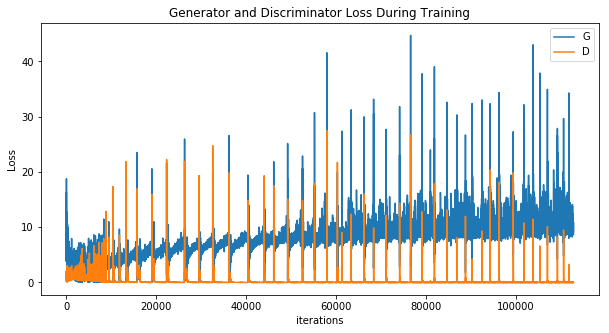

In [16]:
plt.figure(figsize=(10,5))
plt.title("Generator and Discriminator Loss During Training")
plt.plot(G_losses,label="G")
plt.plot(D_losses,label="D")
plt.xlabel("iterations")
plt.ylabel("Loss")
plt.legend()
plt.show()

Animation size has reached 21601834 bytes, exceeding the limit of 20971520.0. If you're sure you want a larger animation embedded, set the animation.embed_limit rc parameter to a larger value (in MB). This and further frames will be dropped.


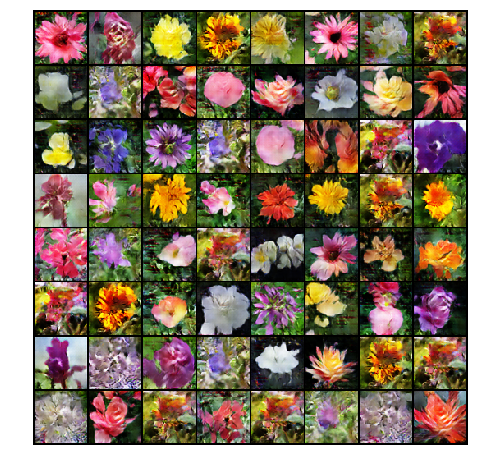

In [17]:
#%%capture
fig = plt.figure(figsize=(8,8))
plt.axis("off")
ims = [[plt.imshow(np.transpose(i,(1,2,0)), animated=True)] for i in img_list]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

HTML(ani.to_jshtml())

Clipping input data to the valid range for imshow with RGB data ([0..1] for floats or [0..255] for integers).


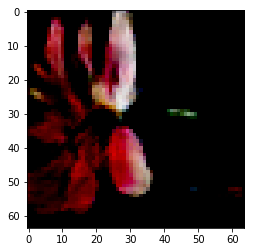

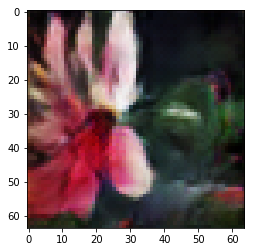

In [72]:
mean = (0.5, 0.5, 0.5)
std = (0.5, 0.5, 0.5)
G = Generator(ngpu).to(device)
gen_fname = "G--1701.ckpt"
path2 = F"gen/{gen_fname}"
G.load_state_dict(torch.load(path2))
#print(G)
G.eval()
noise = torch.randn(10, nz, 1, 1, device=device)
with torch.no_grad():
    fake = G(noise).detach().cpu()
    
fake_tt = np.transpose(fake[0], (1, 2, 0))
imgsdaa = plt.imshow(fake_tt)
plt.show()


for t, m, s in zip(fake, mean, std):
    t.mul_(s).add_(m)

fake_t = fake
fake_t = np.transpose(fake_t[0],(1,2,0))
plt.imshow(fake_t)
plt.show()